# Segmentación Semántica de Imágenes Científicas

In [5]:
import numpy as np
import tensorflow as tf
import keras.backend as K

from keras import regularizers
from keras.engine import get_source_inputs
from keras.engine.topology import Layer
from keras.models import Model
from keras.layers.merge import concatenate, add
from keras.layers import (Input, Conv2D, Conv2DTranspose,
                          UpSampling2D, MaxPooling2D, Dropout, 
                          BatchNormalization, Activation,
                          GaussianNoise, Concatenate, 
                          SpatialDropout2D)

import warnings
warnings.filterwarnings('ignore')

### Introducción: Imágenes Científicas

Datos provenientes de sensores, producidos dentro de una disciplina científica y que codifican información en diferentes bandas => Multidimensionales => Tensores. 
Aplicaciones en Medicina, Biología, Astronomía, Geología, Navegación Autónoma.

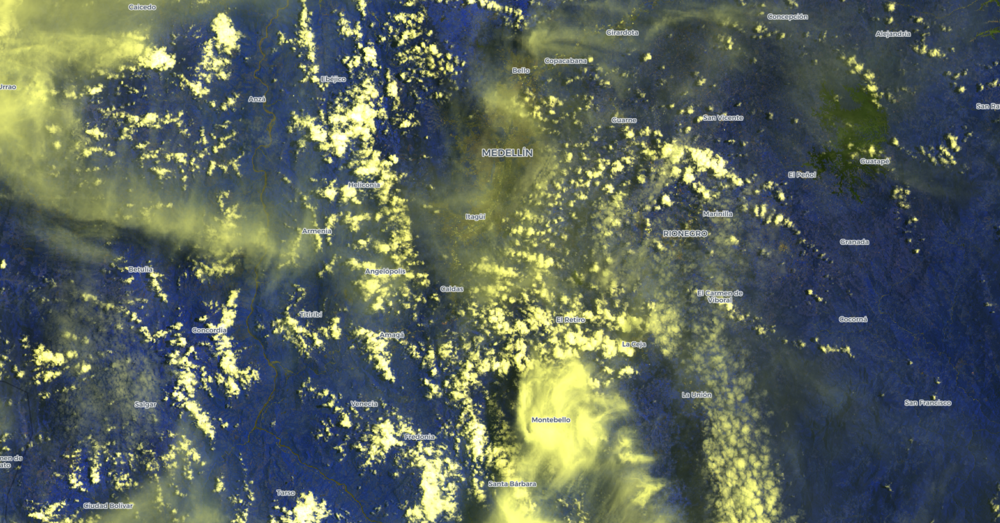

#### Bandas Visibles. 
Las bandas o canales  (o capas) en imagenes científicas, son matrices de datos en dos dimensiones, cuyos elementos están relacionados con la intensidad de la radiancia en un rango de longitud de onda particular del espectro electromagnético.
Las bandas visibles, por ejemplo, son RGBN (Red, Green, Blue, NIR)

#### Bandas Espectrales
- Thermal
- Cirrus
- SWIR
- Soft X-ray
- Bandas L, P, K en SAR (dependiendo de la longitud de onda y el material que absorbe)

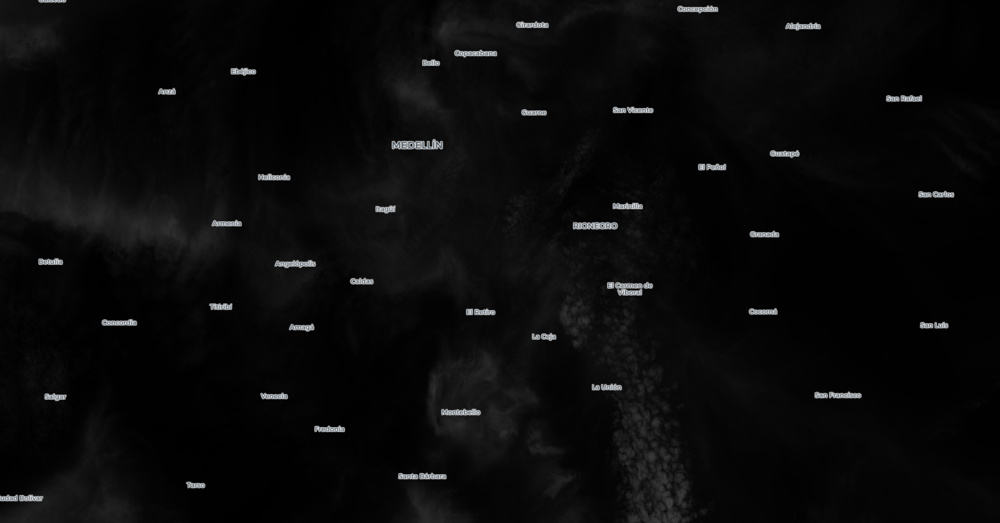

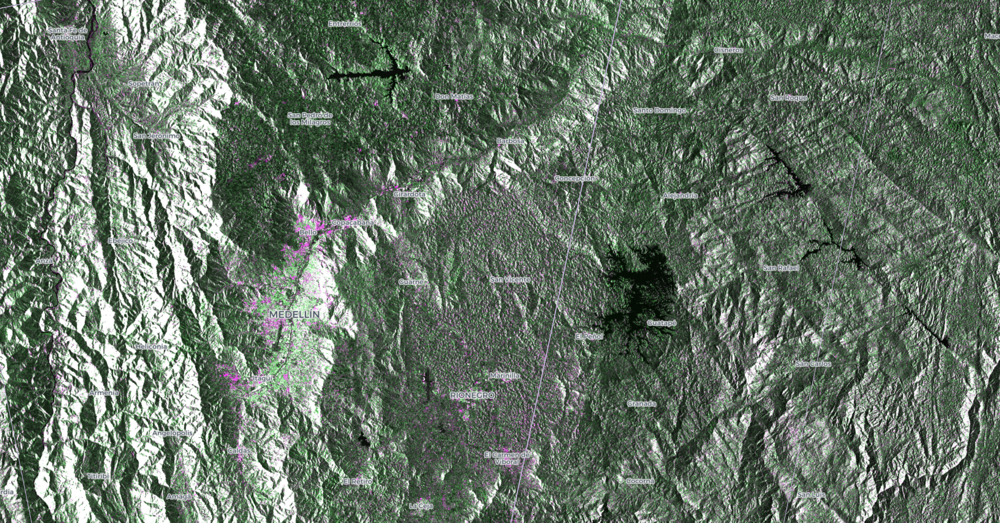

#### Resolución Espectral vs Resolución Espacial
Una mayor resolución espacial conduce a una menor resolución espectral y viceversa. Una resolución espectral final indica que un sensor es sensible a una sola longitud de onda necesita una resolución espacial mas amplia para funcionar correctamente. Mientras que un sensor sensible a un rango de longitudes de onda puede tener una resolución espacial mas fina. 


### Segmentación Semántica
A diferencia de la clasificación de imágenes, la segmentación de imágenes se preocupa no solo de que contiene la imagen, sino donde dicho contenido está localizado. 

La meta de la segmentación semántica es etiquetar cada pixel de una image con la clase correspondiente que está siendo representada. También es comunmente referida como Predicción Densa. 

#### Técnicas Clásicas
- Preprocesamiento: Eliminación de ruido con filtros gausianos, filtros pasabanda. 
- Segmentación Semántica: Region-based, Edge detection-based, Clustering-based

#### Técnicas Modernas
- Deep Convolutional Neural Networks

#### Segmentación basada en umbral
Es una de las técnicas mas usadas en los algorimos basados en región. Determina un umbral óptimo de acuerdo a un criterio específico, y clasificar los pixeles de acuerdo a dicho umbral para lograr clustering. El método de umbral global segmenta la imagen en dos regiones (target y background) usando un único umbral. 

Médodos para seleccionar los umbrales óptimos:
- Basados en varianza interclase (Otsu, maximiza la varianza entre clases)
- Basados en entropía (Shannon, maximiza cantidad de información de cada clase)
- Basados en preservación de momentos.

Cuando el target y el background tienen alto contraste, la segmentación es conseguida óptimamente. Sin embargo, estos métodos solo consideran la información espectral sin considerar la espacial y pierden efectividad cuando la imagen no tiene alto contraste. 

Segmentación basada en crecimiento regional.
La idea básica de esta técnica es combinar pixeles con propiedades similares para formar una region, es decir, para cada región se debe encontrar un píxel "semilla" como punto de crecimiento, y luego unir los pixeles vecinos con propiedades similares. 


### Segmentación basada en detección de bordes.
Se refiere a el uso de detección de área basada en regiones conectadas y/o separadas por discontinuidades de color o escala de grises para lograr la segmentación de la imagen. 
Existen diferentes algoritmos para detección de bordes:
- Sobel method
- Canny method


### Segmentación semántica basada en CNN.

Una arquitectura común de red neuronal para esta tarea es simplemente una serie de capas convolucionales (con `padding = same` para preservar las dimensiones) y como salida un mapa de segmentación. 

Dicho mapa de segmentación se produce colapsando la predicción de cada pixel tomando el `argmax`. Cuando creamos este mapa de segmentación de salida, usualmente nos referimos a el como `mask`, la cual usualmente es sobrepuesta a las entradas originales para "iluminar" las regiones donde una clase en específico está presente. 

Típicamente se require incrementar el número de features a medida que vamos mas profundo en la red neuronal => **Encoding / Decoding**.
Downsampling de resolución espacial para el desarrollo de mapas de features de baja resolución, las cuales son aprendidas de manera muy eficiente. Luego se procede a realizar upsampling para lograr un mapa de segmentación con full-resolution. 

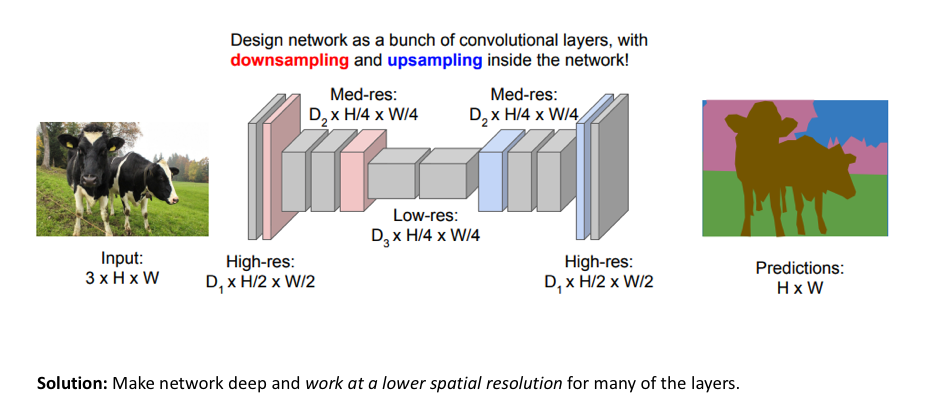

#### Downsampling
Usualmente usamos operaciones de `pooling` que sumarizan un área local con un única valor, es decir, tomando el promedio o `MaxPooling2D`. 

#### Upsampling
Existen varias técnicas que pueden ser usadas para realizar upsampling de un mapa de features. Cuando realizamos "unpooling" debemos realizar upsampling distribuyendo un único valor en un área de mas alta resolución. 
Sin embargo, últimamente han ganado mucha popularidad las operaciones de upsample llamadas **Transpose Convolutions**, las cuales permiten desarrollar un upsampling "aprendido".

Tomamos un único valor de un mapa de features de baja resolución y multiplicamos todos los pesos en nuestro filtro por este valor, proyectado estos valores ponderados en un mapa de salida: `Conv2DTranspose`

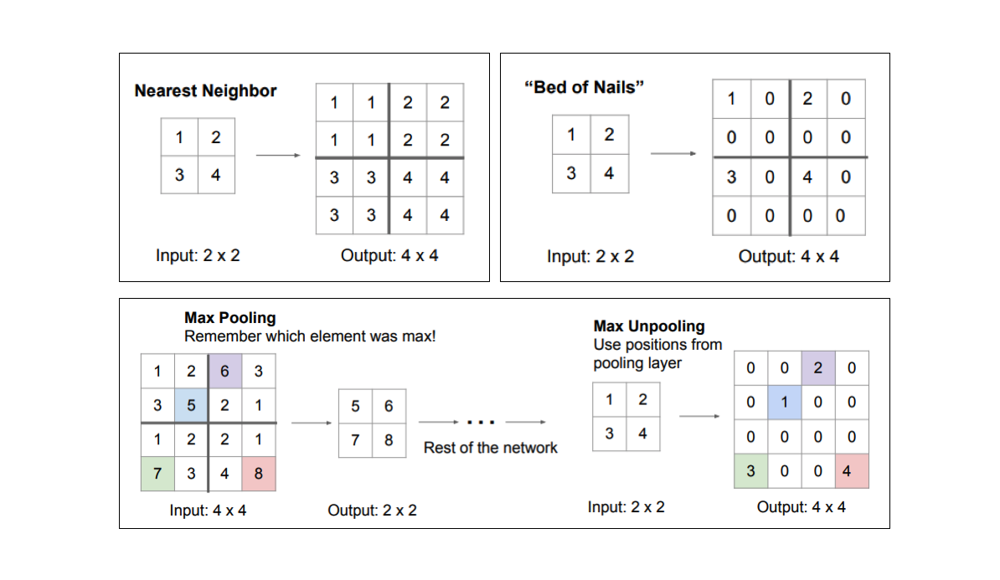

### Fully convolutional networks

#### AlexNet
AlexNet fue desarrollada por Alex Krizhevsky et al. in 2012 para la competencia de ImageNet. La arquitectura en general es muy similar a LeNet-5, sin embargo el model es considerablemente mas grande. El éxito de este modelo convenció a la comunidad de CV de usar de manera seria Deep Learning para tareas de computer vision. 

https://www.nvidia.cn/content/tesla/pdf/machine-learning/imagenet-classification-with-deep-convolutional-nn.pdf

La técnica de segmentación semántica usando redes fully convolutional fue introducida por [Long et al](https://arxiv.org/abs/1411.4038) en 2014. El autor propone en el paper adaptar una arquitectura existente bien estudiada de clasificación de imágenes, por ejemplo AlexNet, para servir como el módulo de encoding de la red, añadiendo un módulo de decoding con capas convolucionales transpuestas para realizar upsample de las features de baja resolución en un mapa de segmentación de resolución full. 

En dicha propuesta sin embargo, el módulo de encoding reduce la resolución de la entrada por un factor de 32, por lo tanto el módulo de decoding tiene problemas para producir segmentaciones de alta resolución. 
El autor soluciona este inconveniente realizando el upsampling en etapas, lentemante, por medio de la adición de "skip connections" de capas anteriores, y sumando estos dos mapas de features. 

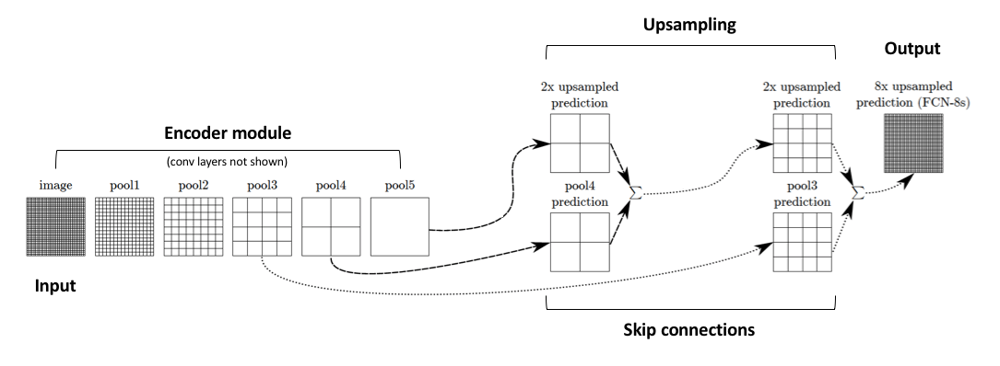


### U-Net
U-Net es una arquitectura inicialmente concebida para segmentación de imágenes biométricas. 

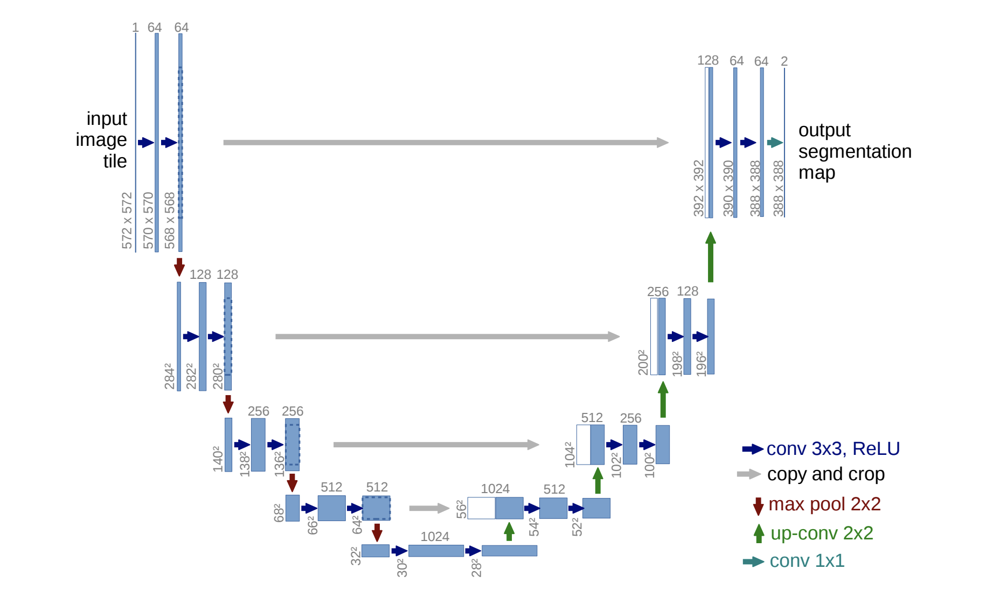

https://arxiv.org/abs/1505.04597

### Variaciones de U-Net
Existen otras arquitecturas que permiten construír capas convolucionaes en una manera que permita aprendizaje de manera mas efectiva. Dichas arquitecturas están basadas en una unidad repetible que es usada a través de la red. 

Drozdal et al reemplazan las redes fully-convolutional en favor de los bloques residuales. Dichos bloques residuales introducen skip connections cortas en conjunto con skip connections largas entre los mapas de features correspondientes a los módulos de encoding y decoding encontradas en la estructura U-net estandard. 

Otros autores como Jegou et al proponen el uso de bloques densos, los cuales todavía siguen una estructura U-Net, argumentando que las características de las DenseNets las hacen muy buenas para segmentación semántica puesto que introducne naturalmente skip connections.


In [10]:
def UNet(n1_filters=32, n_bands=4, n_classes=4, 
         depth=5, kernel=(3, 3), activation='relu',
         padding='same', dilation_rate=1, input_highway=False,
         noise=0.0, learn_upsample=False, get_logits=False,
         do_batch_norm=False, dropout_val=0.0, l2_reg_val=0.0):
    inputs = Input((None, None, n_bands))
    convolutions = list()
    x = inputs
    conv_kwargs = dict(kernel_size=kernel,
                       activation=activation,
                       padding=padding,
                       dilation_rate=dilation_rate,
                       kernel_regularizer=regularizers.l2(l2_reg_val))

    for i in range(depth):
        conv = Conv2D(n1_filters * 2**i, **conv_kwargs)(x)
        if do_batch_norm: conv = BatchNormalization()(conv)
        conv = SpatialDropout2D(dropout_val)(conv)
        conv = Conv2D(n1_filters * 2**i, **conv_kwargs)(conv)
        if do_batch_norm: conv = BatchNormalization()(conv) 
        convolutions.append(conv)
        if i < depth - 1:
            x = MaxPooling2D(pool_size=(2, 2))(conv)

    for i in range(depth - 2, -1, -1):
        if learn_upsample:
            up = Conv2DTranspose(n1_filters * 2**(i+1), (2, 2), strides=(2, 2), padding=padding)(conv)
        else:
            up = UpSampling2D(size=(2, 2))(conv)
        up = concatenate([up, convolutions[i]], axis=3)
        conv = Conv2D(n1_filters * 2**i, **conv_kwargs)(up)
        if do_batch_norm: conv = BatchNormalization()(conv) 
        conv = Conv2D(n1_filters * 2**i, **conv_kwargs)(conv)
        if do_batch_norm: conv = BatchNormalization()(conv) 

    if input_highway:
        conv = concatenate([conv, inputs])

    conv = Conv2D(n_classes, (1, 1), activation='linear')(conv)
    conv = GaussianNoise(noise)(conv)  # if noise==0, this does nothing
    if get_logits:
        output = conv
    else:
        output = Activation('sigmoid')(conv)

    return Model(inputs=inputs, outputs=[output], name='UNet')


In [9]:
unet = UNet(n_bands=8, n_classes=2, dilation_rate=2)